In [1]:
### Part 01. Load packages and libs

In [2]:
import os
import time
import warnings
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary

from tqdm import tqdm
import albumentations as A
from albumentations.pytorch import ToTensorV2

torch.cuda.empty_cache()

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

warnings.filterwarnings("ignore")

In [3]:
### Part 02. Writing a custom dataset for Blood Cell Segmemtation dataset, write data loader to load data for train model

In [4]:
TRAIN_IMG_DIR = "datasets/blood_cell/train/original"
TRAIN_MASK_DIR = "datasets/blood_cell/train/mask"
VAL_IMG_DIR = "datasets/blood_cell/test/original"
VAL_MASK_DIR = "datasets/blood_cell/test/mask"

In [5]:
class BloodCellDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None) -> None:
        super(BloodCellDataset, self).__init__()
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        image_path = os.path.join(self.image_dir, self.images[index])
        mask_path = os.path.join(
            self.mask_dir, self.images[index].replace(".jpg", ".png"))

        image = np.array(Image.open(image_path).convert("RGB"))
        mask = np.array(Image.open(mask_path).convert("L"),
                        dtype=np.float32)
        mask[mask == 255.0] = 1.0

        if self.transform is not None:
            augemantations = self.transform(image=image, mask=mask)
            image = augemantations['image']
            mask = augemantations['mask']
        return image, mask

In [6]:
def get_data_loaders(
        train_dir, train_mask_dir, val_dir, val_maskdir, batch_size,
        train_transform, val_transform):

    train_ds = BloodCellDataset(
        image_dir=train_dir, mask_dir=train_mask_dir,
        transform=train_transform)

    train_loader = DataLoader(
        train_ds,
        batch_size=batch_size,
        shuffle=True,
    )

    val_ds = BloodCellDataset(
        image_dir=val_dir,
        mask_dir=val_maskdir,
        transform=val_transform,
    )

    val_loader = DataLoader(
        val_ds,
        batch_size=batch_size,
        shuffle=False,
    )

    return train_loader, val_loader

In [7]:
train_transform = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

In [8]:
BATCH_SIZE = 16

train_loader, val_loader = get_data_loaders(
    TRAIN_IMG_DIR,
    TRAIN_MASK_DIR,
    VAL_IMG_DIR,
    VAL_MASK_DIR,
    BATCH_SIZE,
    train_transform,
    val_transforms
)

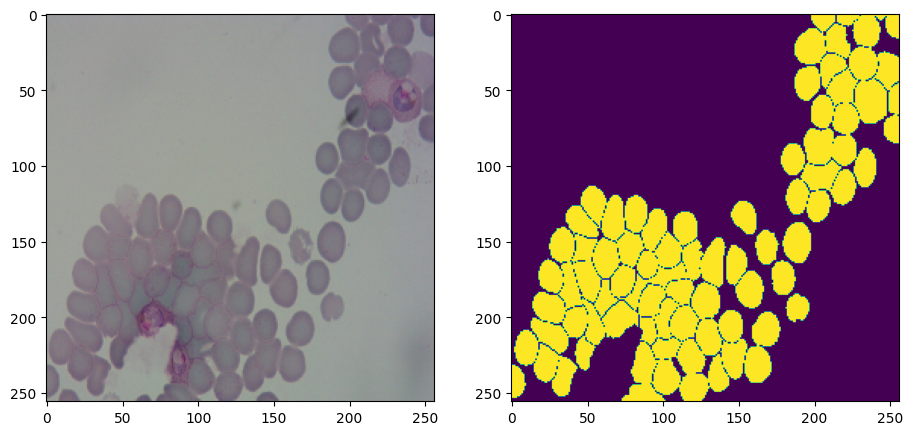

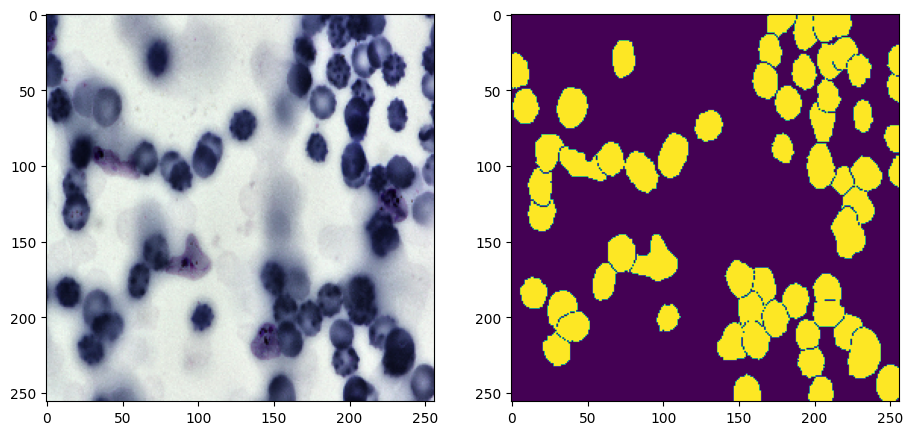

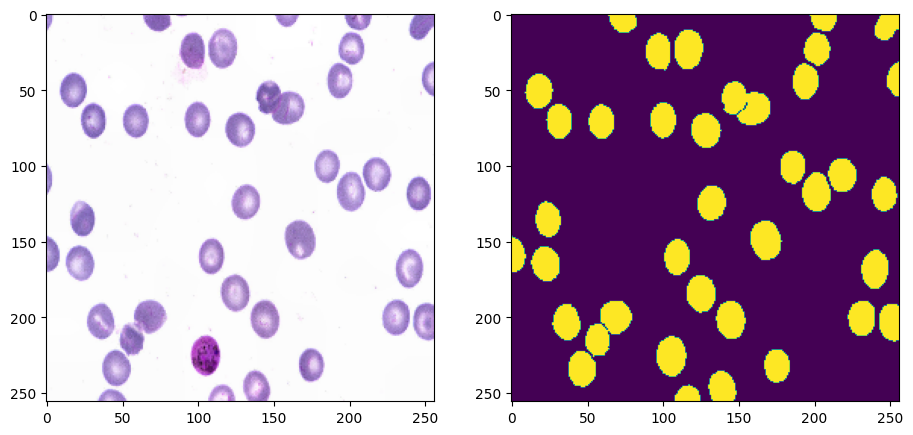

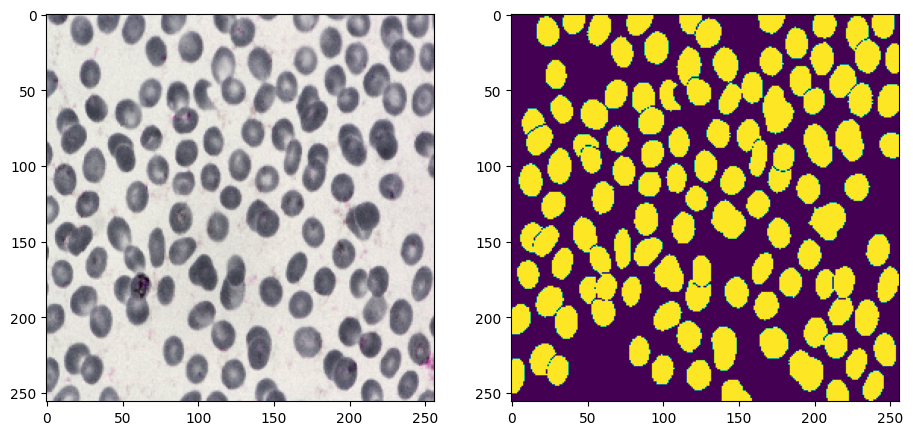

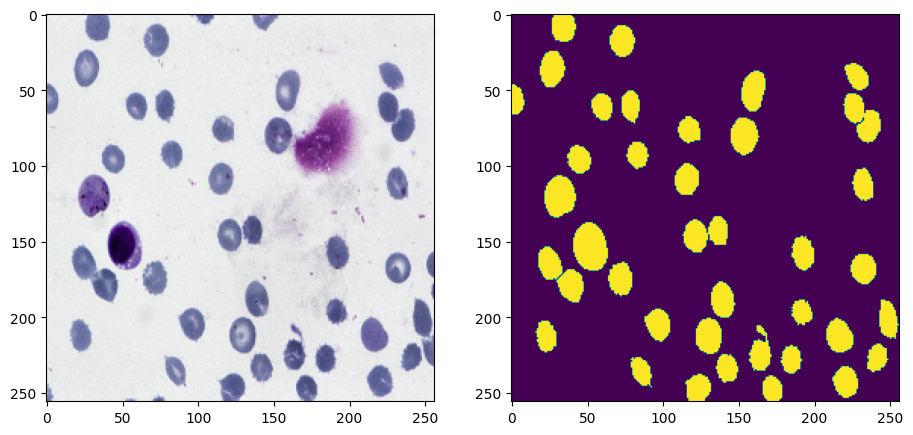

...

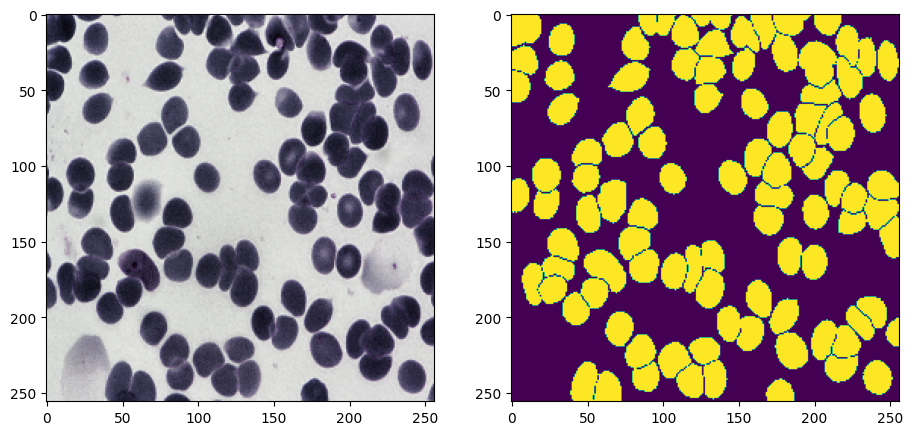

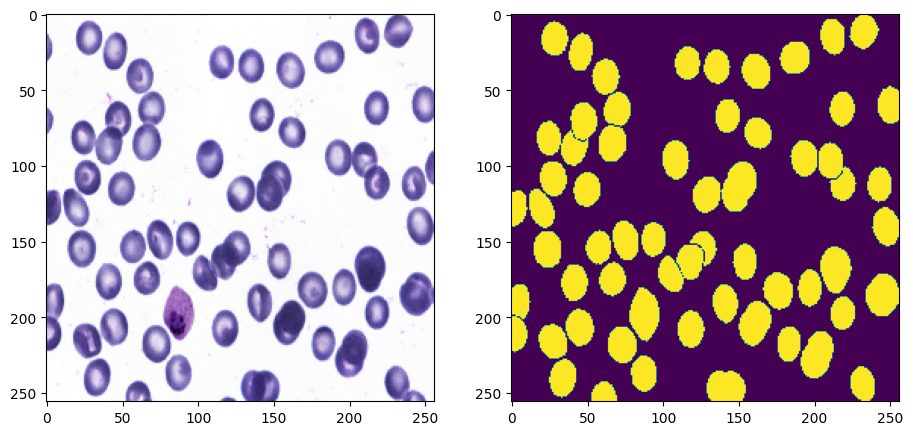

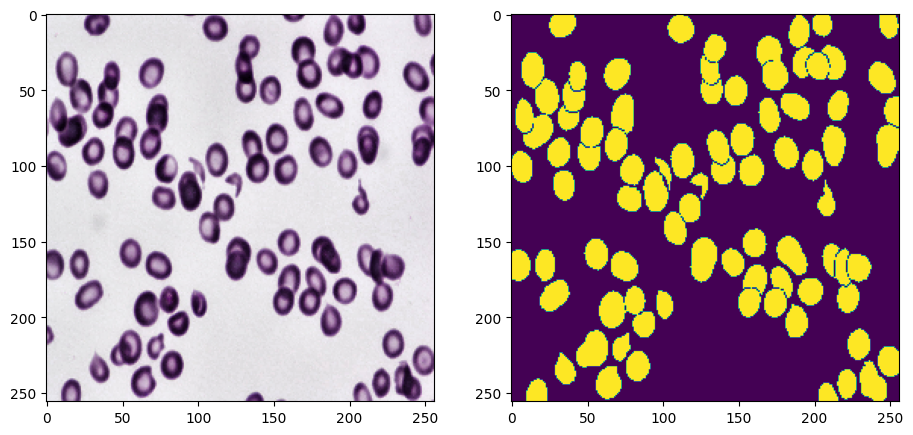

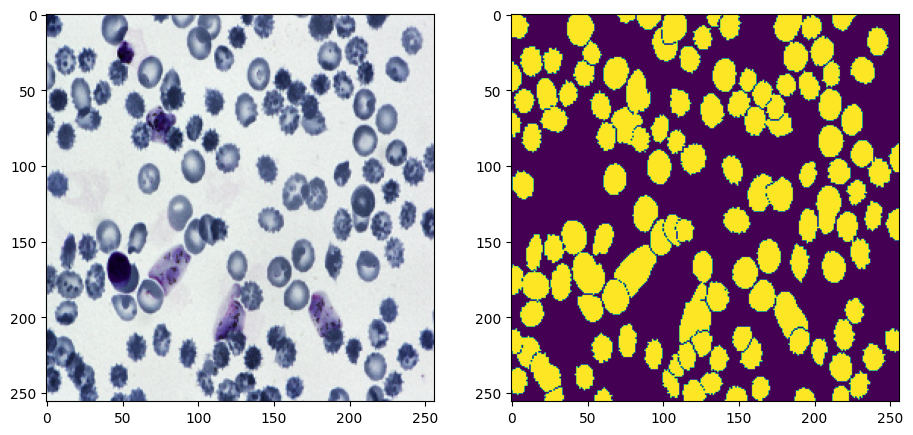

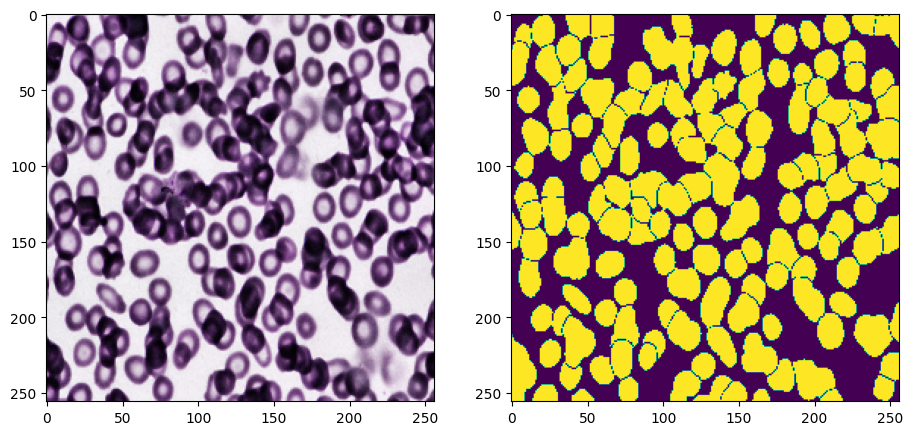

In [9]:
def show_transformed(data_loader):
    batch = next(iter(data_loader))
    images, labels = batch

    for img, mask in zip(images, labels):
        plt.figure(figsize=(11, 11))

        plt.subplot(1, 2, 1)
        plt.imshow(np.transpose(img, (1, 2, 0)))

        plt.subplot(1, 2, 2)
        plt.imshow(mask.reshape(mask.shape[0], mask.shape[1], 1))


show_transformed(val_loader)

In [10]:
train_loader.dataset[0][0].shape
train_loader.dataset[0][1].shape

torch.Size([256, 256])

In [11]:
class FCN(nn.Module):
    def __init__(self, num_classes):
        super(FCN, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3,
                               padding=1)  # 3 channels for RGB
        self.conv2 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv3 = nn.Conv2d(128, 256, kernel_size=3, padding=1)

        self.relu = nn.ReLU()
        self.deconv1 = nn.ConvTranspose2d(256, 128, kernel_size=3, padding=1)
        self.deconv2 = nn.ConvTranspose2d(128, 64, kernel_size=3, padding=1)
        self.deconv3 = nn.ConvTranspose2d(
            64, num_classes, kernel_size=3, padding=1)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))

        x = F.relu(self.deconv1(x))
        x = F.relu(self.deconv2(x))
        x = self.deconv3(x)

        return x

In [12]:
class DiceBCELoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceBCELoss, self).__init__()
        self.bce_losss = nn.BCEWithLogitsLoss()

    def forward(self, inputs, targets, smooth=1):
        BCE = self.bce_losss(inputs, targets)
        inputs = torch.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        dice_loss = 1 - (2.*intersection + smooth)/(
            inputs.sum() + targets.sum() + smooth)
        Dice_BCE = BCE + dice_loss
        return Dice_BCE


class IOU(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(IOU, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        inputs = torch.sigmoid(inputs)

        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        total = (inputs + targets).sum()
        union = total - intersection

        IoU = (intersection + smooth)/(union + smooth)
        return IoU

In [13]:
model = FCN(num_classes=1).to(DEVICE)
loss_fn = DiceBCELoss()

iou_fn = IOU()
scaler = torch.cuda.amp.GradScaler()
LEARNING_RATE = 1e-4
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

train_iou = []
train_loss = []
train_dice = []

def save_checkpoint(state, filename="model.pth.tar"):
    print("=> Saving checkpoint")
    # torch.save(state, filename)

In [14]:
model

FCN(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu): ReLU()
  (deconv1): ConvTranspose2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (deconv2): ConvTranspose2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (deconv3): ConvTranspose2d(64, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
)

In [15]:
print(model)

FCN(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu): ReLU()
  (deconv1): ConvTranspose2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (deconv2): ConvTranspose2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (deconv3): ConvTranspose2d(64, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
)


In [16]:
summary(model, (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           1,792
            Conv2d-2        [-1, 128, 256, 256]          73,856
            Conv2d-3        [-1, 256, 256, 256]         295,168
   ConvTranspose2d-4        [-1, 128, 256, 256]         295,040
   ConvTranspose2d-5         [-1, 64, 256, 256]          73,792
   ConvTranspose2d-6          [-1, 1, 256, 256]             577
Total params: 740,225
Trainable params: 740,225
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.75
Forward/backward pass size (MB): 320.50
Params size (MB): 2.82
Estimated Total Size (MB): 324.07
----------------------------------------------------------------


In [17]:
start_time = time.time()

# let's train it just for 2 epochs
NUM_EPOCHS = 16

for epoch in range(NUM_EPOCHS):
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}")

    iterations = 0
    iter_loss = 0.0
    iter_iou = 0.0

    batch_loop = tqdm(train_loader)
    for batch_idx, (data, targets) in enumerate(batch_loop):

        data = data.to(device=DEVICE)
        targets = targets.float().unsqueeze(1).to(device=DEVICE)

        with torch.cuda.amp.autocast():
            predictions = model(data)
            loss = loss_fn(predictions, targets)
            iou = iou_fn(predictions, targets)

            iter_loss += loss.item()
            iter_iou += iou.item()

        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()

        iterations += 1
        batch_loop.set_postfix(diceloss=loss.item(), iou=iou.item())

    train_loss.append(iter_loss / iterations)
    train_iou.append(iter_iou / iterations)
    # print(
    #     f"Epoch: {epoch+1}/{NUM_EPOCHS}, Training loss: {round(train_loss[-1] , 3)}")
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}, IoU score: {iter_iou / iterations}")

    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict()
    }
    # save_checkpoint(checkpoint)

    num_correct = 0
    num_pixels = 0
    dice_score = 0
    model.eval()

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(DEVICE)
            y = y.to(DEVICE).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds = (preds > 0.5).float()
            num_correct += (preds == y).sum()
            num_pixels += torch.numel(preds)
            dice_score += (2 * (preds * y).sum()) / (
                (preds + y).sum() + 1e-8
            )

    # print(
    #     f"Got {num_correct}/{num_pixels} with acc {num_correct/num_pixels*100:.2f}"
    # )
    print(
        f"Epoch: {epoch+1}/{NUM_EPOCHS}, Total num_correct/num_pixels: {num_correct}/{num_pixels} => {num_correct/num_pixels}"
    )
    print(
        f"Epoch: {epoch+1}/{NUM_EPOCHS}, Dice score: {dice_score / len(val_loader)}")
    train_dice.append(dice_score / len(val_loader))
    model.train()

print("done ..")

end_time = time.time()
training_time = end_time - start_time
print(
    f"The training time of the Fully Convolutional Network (FCN) model is: {training_time:.2f} seconds")

Epoch: 1/16


100%|██████████| 74/74 [37:34<00:00, 30.46s/it, diceloss=0.198, iou=0.845]


Epoch: 1/16, IoU score: 0.5825044357696095
Epoch: 1/16, Total num_correct/num_pixels: 9653909/10420224 => 0.9264588952064514
Epoch: 1/16, Dice score: 0.8730180859565735
Epoch: 2/16


100%|██████████| 74/74 [37:21<00:00, 30.29s/it, diceloss=0.0863, iou=0.877]


Epoch: 2/16, IoU score: 0.7745893678149661
Epoch: 2/16, Total num_correct/num_pixels: 9824365/10420224 => 0.9428170919418335
Epoch: 2/16, Dice score: 0.905720055103302
Epoch: 3/16


100%|██████████| 74/74 [37:19<00:00, 30.26s/it, diceloss=0.512, iou=0.768]


Epoch: 3/16, IoU score: 0.800017886065148
Epoch: 3/16, Total num_correct/num_pixels: 9804799/10420224 => 0.9409393668174744
Epoch: 3/16, Dice score: 0.9009798169136047
Epoch: 4/16


100%|██████████| 74/74 [37:34<00:00, 30.47s/it, diceloss=0.176, iou=0.852]


Epoch: 4/16, IoU score: 0.8095103397562697
Epoch: 4/16, Total num_correct/num_pixels: 9908043/10420224 => 0.9508473873138428
Epoch: 4/16, Dice score: 0.9209202527999878
Epoch: 5/16


100%|██████████| 74/74 [37:31<00:00, 30.42s/it, diceloss=0.205, iou=0.849]


Epoch: 5/16, IoU score: 0.8165137220073391
Epoch: 5/16, Total num_correct/num_pixels: 9912477/10420224 => 0.9512729048728943
Epoch: 5/16, Dice score: 0.9224420785903931
Epoch: 6/16


100%|██████████| 74/74 [37:33<00:00, 30.45s/it, diceloss=0.346, iou=0.735]


Epoch: 6/16, IoU score: 0.8224260291537723
Epoch: 6/16, Total num_correct/num_pixels: 9947317/10420224 => 0.9546164274215698
Epoch: 6/16, Dice score: 0.9289304614067078
Epoch: 7/16


100%|██████████| 74/74 [37:24<00:00, 30.33s/it, diceloss=0.129, iou=0.887]


Epoch: 7/16, IoU score: 0.8319822751186989
Epoch: 7/16, Total num_correct/num_pixels: 9936247/10420224 => 0.953554093837738
Epoch: 7/16, Dice score: 0.9261703491210938
Epoch: 8/16


100%|██████████| 74/74 [37:27<00:00, 30.37s/it, diceloss=0.227, iou=0.904]


Epoch: 8/16, IoU score: 0.8389681174948409
Epoch: 8/16, Total num_correct/num_pixels: 9960715/10420224 => 0.9559022188186646
Epoch: 8/16, Dice score: 0.9290065765380859
Epoch: 9/16


100%|██████████| 74/74 [35:29<00:00, 28.77s/it, diceloss=0.158, iou=0.864]


Epoch: 9/16, IoU score: 0.8284273977215225
Epoch: 9/16, Total num_correct/num_pixels: 9708642/10420224 => 0.9317114353179932
Epoch: 9/16, Dice score: 0.8804448246955872
Epoch: 10/16


100%|██████████| 74/74 [35:29<00:00, 28.78s/it, diceloss=0.15, iou=0.866] 


Epoch: 10/16, IoU score: 0.8342216828384915
Epoch: 10/16, Total num_correct/num_pixels: 9978404/10420224 => 0.9575997591018677
Epoch: 10/16, Dice score: 0.934352695941925
Epoch: 11/16


100%|██████████| 74/74 [35:29<00:00, 28.78s/it, diceloss=0.108, iou=0.902]


Epoch: 11/16, IoU score: 0.8481336461531149
Epoch: 11/16, Total num_correct/num_pixels: 9984942/10420224 => 0.9582272171974182
Epoch: 11/16, Dice score: 0.9329144358634949
Epoch: 12/16


100%|██████████| 74/74 [36:04<00:00, 29.25s/it, diceloss=0.35, iou=0.732] 


Epoch: 12/16, IoU score: 0.8498190560856381
Epoch: 12/16, Total num_correct/num_pixels: 9842080/10420224 => 0.9445171356201172
Epoch: 12/16, Dice score: 0.9051415324211121
Epoch: 13/16


100%|██████████| 74/74 [35:32<00:00, 28.82s/it, diceloss=0.257, iou=0.715]


Epoch: 13/16, IoU score: 0.8254903627408517
Epoch: 13/16, Total num_correct/num_pixels: 9967841/10420224 => 0.9565860629081726
Epoch: 13/16, Dice score: 0.9291003346443176
Epoch: 14/16


100%|██████████| 74/74 [35:41<00:00, 28.93s/it, diceloss=0.462, iou=0.541]


Epoch: 14/16, IoU score: 0.849069828117216
Epoch: 14/16, Total num_correct/num_pixels: 9820741/10420224 => 0.9424692988395691
Epoch: 14/16, Dice score: 0.901084303855896
Epoch: 15/16


100%|██████████| 74/74 [34:21<00:00, 27.86s/it, diceloss=0.128, iou=0.895]


Epoch: 15/16, IoU score: 0.8248075319303049
Epoch: 15/16, Total num_correct/num_pixels: 9977088/10420224 => 0.9574734568595886
Epoch: 15/16, Dice score: 0.9312100410461426
Epoch: 16/16


100%|██████████| 74/74 [22:37<00:00, 18.34s/it, diceloss=0.347, iou=0.693]


Epoch: 16/16, IoU score: 0.8499645461907258
Epoch: 16/16, Total num_correct/num_pixels: 9960847/10420224 => 0.9559148550033569
Epoch: 16/16, Dice score: 0.9272720217704773
done ..
The training time of the Fully Convolutional Network (FCN) model is: 35820.42 seconds


In [18]:
print(train_loss)

[0.5495611948741449, 0.28355765825993307, 0.25570099559184667, 0.23938215080950712, 0.23014564409449295, 0.2234871286798168, 0.20852365082985647, 0.20069315787908193, 0.2169638600301098, 0.2062921735483247, 0.18743162511571035, 0.18548132902061618, 0.21968094440730843, 0.18380071736268094, 0.2231305821521862, 0.18324063456541784]


In [19]:
print(train_iou)

[0.5825044357696095, 0.7745893678149661, 0.800017886065148, 0.8095103397562697, 0.8165137220073391, 0.8224260291537723, 0.8319822751186989, 0.8389681174948409, 0.8284273977215225, 0.8342216828384915, 0.8481336461531149, 0.8498190560856381, 0.8254903627408517, 0.849069828117216, 0.8248075319303049, 0.8499645461907258]


In [20]:
print(train_dice)

[tensor(0.8730), tensor(0.9057), tensor(0.9010), tensor(0.9209), tensor(0.9224), tensor(0.9289), tensor(0.9262), tensor(0.9290), tensor(0.8804), tensor(0.9344), tensor(0.9329), tensor(0.9051), tensor(0.9291), tensor(0.9011), tensor(0.9312), tensor(0.9273)]


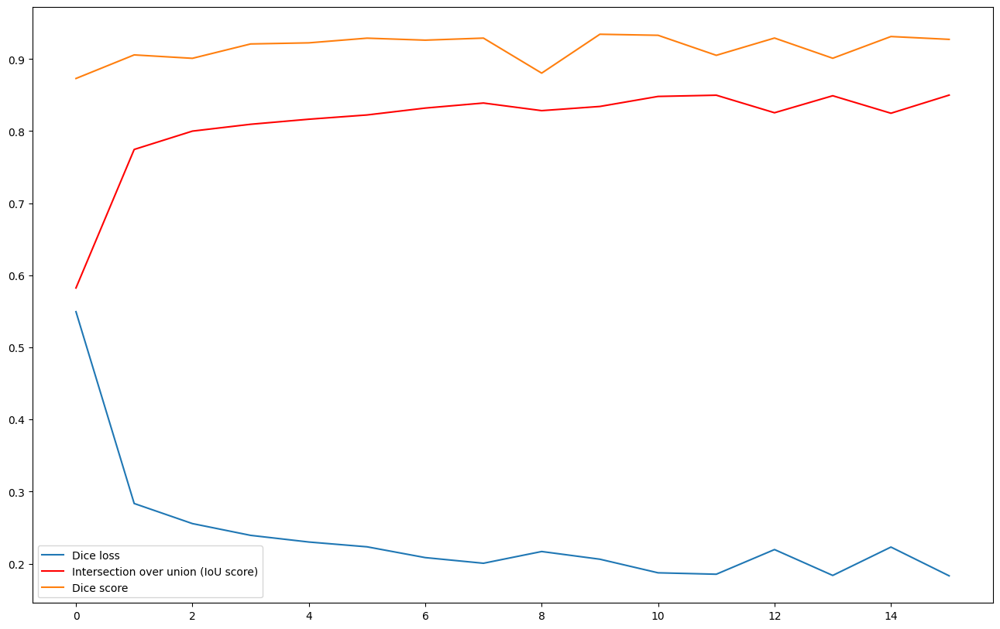

In [21]:
f = plt.figure(figsize=(16, 10))
plt.plot(train_loss, label='Dice loss')
# plt.plot(train_iou, label='Intersection over union (IoU score)')
plt.plot(train_iou, label='Intersection over union (IoU score)', color='red')
plt.plot(train_dice, label='Dice score')
plt.legend()
plt.show()

In [22]:
def test_model(model, val_loader, device):
    model.eval()
    dice_score = 0
    iou_metric = IOU()
    iou_score = 0

    with torch.no_grad():
        for x, y in tqdm(val_loader, desc="Testing"):
            x = x.to(device)
            y = y.to(device).unsqueeze(1)

            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            dice_score += (2 * (preds_binary * y).sum()) / (
                (preds_binary + y).sum() + 1e-8
            )
            iou_score += iou_metric(preds_binary, y)

    avg_dice = dice_score / len(val_loader)
    avg_iou = iou_score / len(val_loader)

    print(f"Average Dice Score: {avg_dice:.4f}")
    print(f"Average IoU Score: {avg_iou:.4f}")

    return avg_dice, avg_iou


# Run the test function
avg_dice, avg_iou = test_model(model, val_loader, DEVICE)

Testing: 100%|██████████| 10/10 [01:07<00:00,  6.70s/it]

Average Dice Score: 0.9273
Average IoU Score: 0.3339


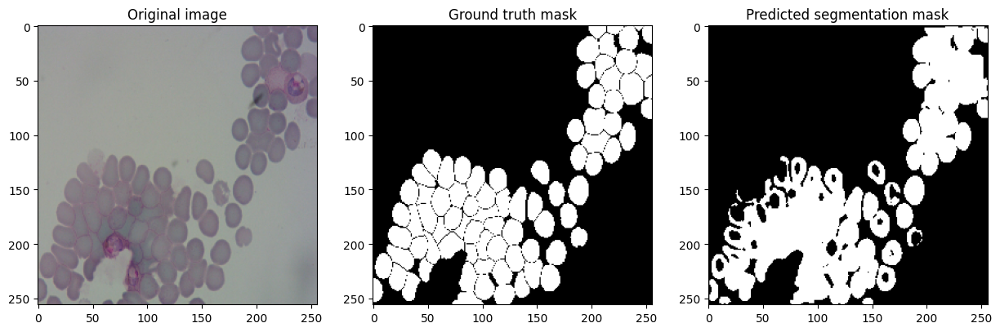

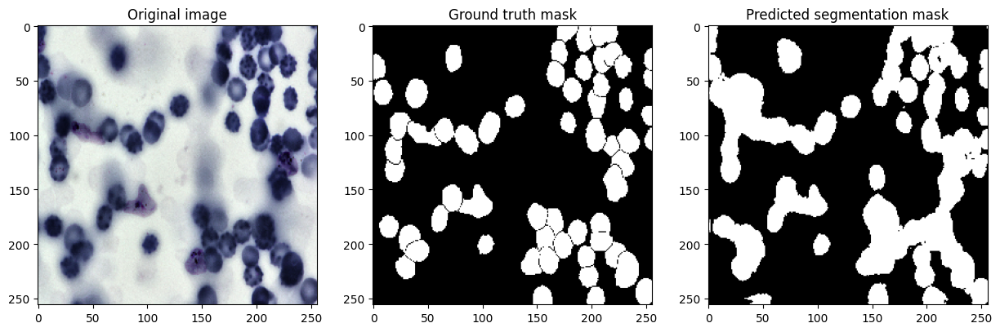

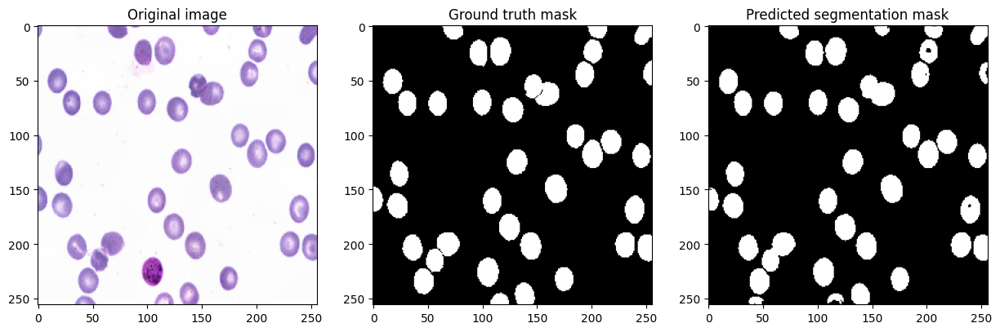

In [23]:
def visualize_predictions(model, val_loader, device, num_samples=3):
    model.eval()
    samples = 0

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(device)
            y = y.to(device).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            for i in range(x.size(0)):
                if samples >= num_samples:
                    break

                plt.figure(figsize=(15, 5))

                plt.subplot(1, 3, 1)
                plt.title("Original image")
                plt.imshow(np.transpose(x[i].cpu().numpy(), (1, 2, 0)))

                # Ground Truth
                plt.subplot(1, 3, 2)
                plt.title("Ground truth mask")
                plt.imshow(y[i].cpu().numpy().squeeze(), cmap="gray")

                # Predicted Mask
                plt.subplot(1, 3, 3)
                plt.title("Predicted segmentation mask")
                plt.imshow(preds_binary[i].cpu(
                ).numpy().squeeze(), cmap="gray")

                plt.show()
                samples += 1

            if samples >= num_samples:
                break


visualize_predictions(model, val_loader, DEVICE)

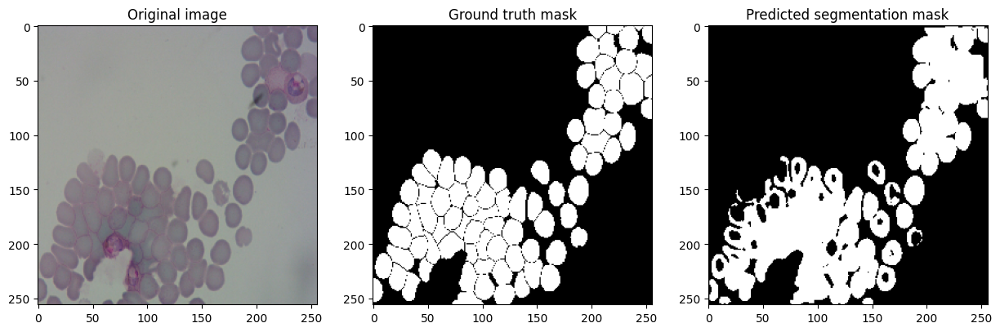

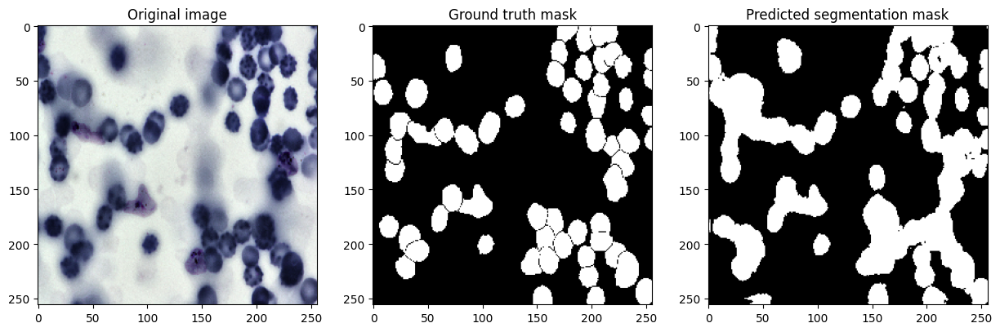

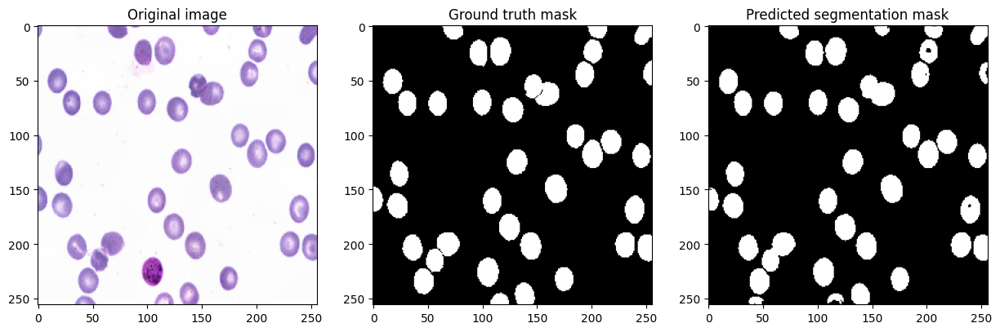

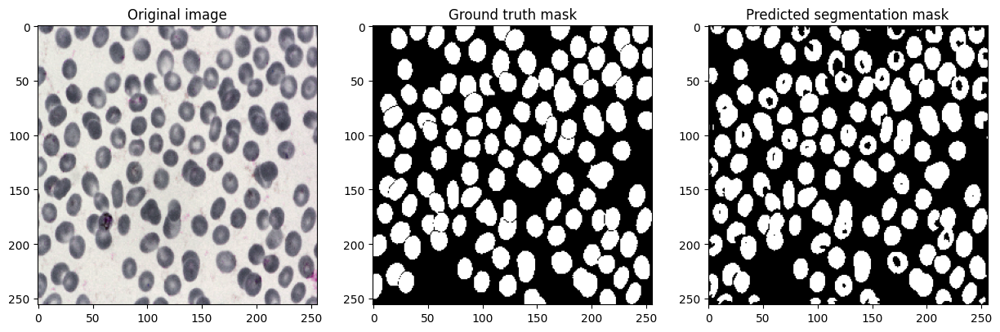

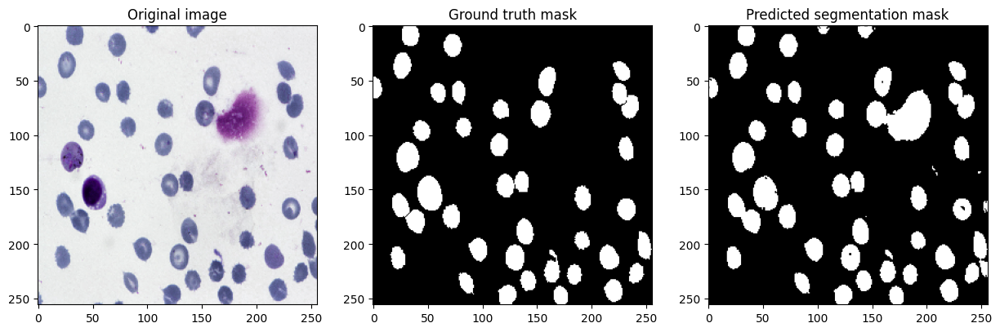

...

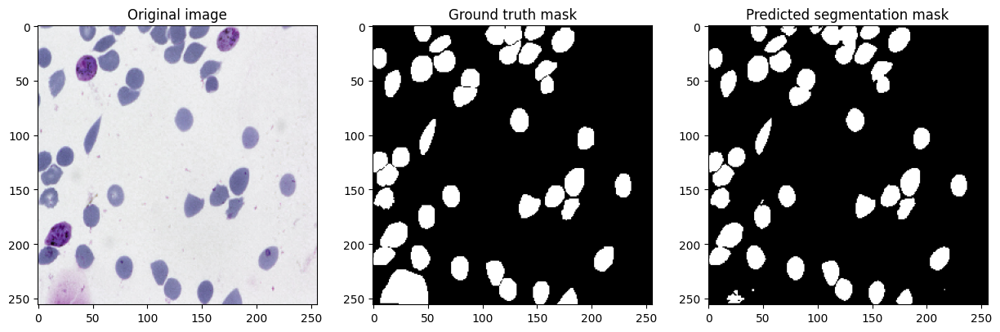

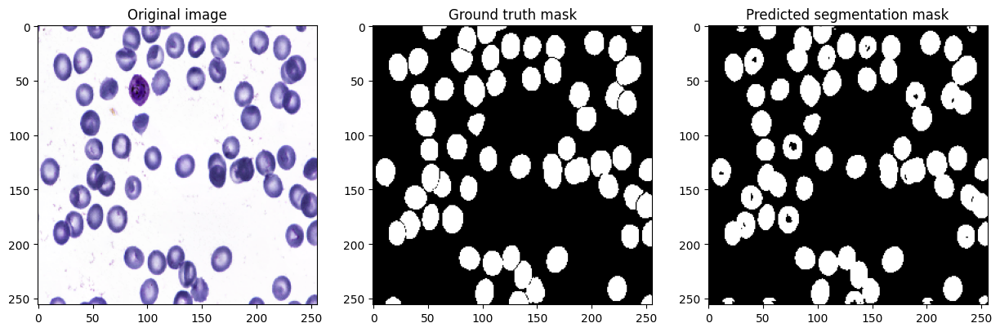

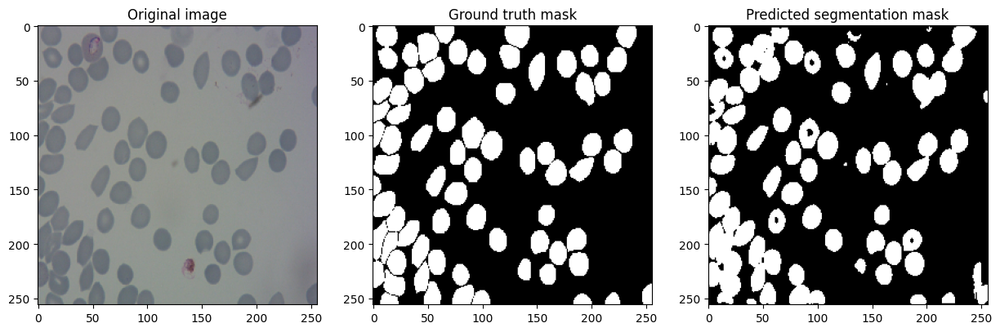

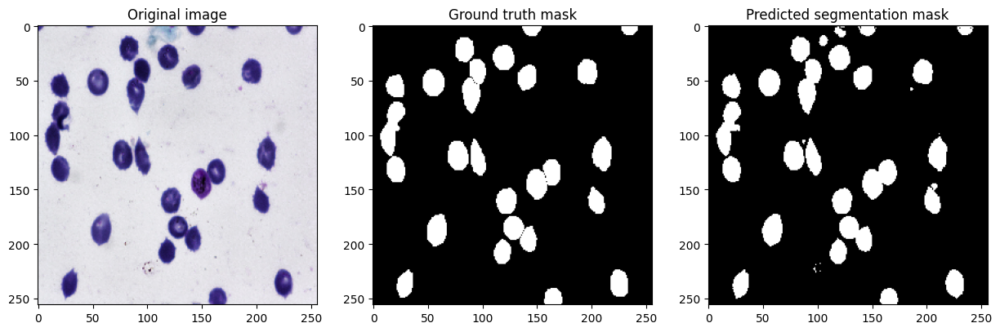

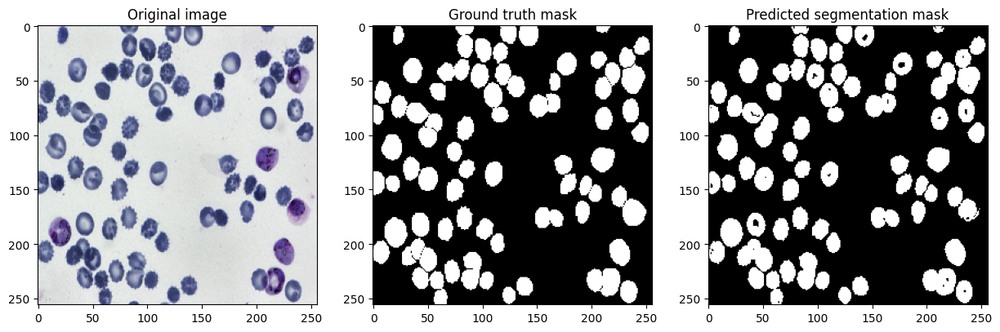

In [24]:
visualize_predictions(model, val_loader, DEVICE, num_samples=100)